# Matching conductance and radius of gyration changes

In [1]:
import MDAnalysis as mda
from MDAnalysis.analysis.base import (AnalysisBase,
                                      AnalysisFromFunction,
                                      analysis_class)
import pickle
import numpy as np
import pandas as pd
from statistics import median
import matplotlib.pyplot as plt
%matplotlib inline

/homes/sanjuan/.local/lib/python3.8/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/homes/sanjuan/.local/lib/python3.8/site-packages/MDAnalysis/coordinates/TRJ.py:1209: DeprecationWarning: Please use `netcdf_file` from the `scipy.io` namespace, the `scipy.io.netcdf` namespace is deprecated.
  class NCDFPicklable(scipy.io.netcdf.netcdf_file):


Load conductance data

In [2]:
filepath = 'data/Gpred_Rmin_timeseries_cleaned.pickle'
df_conductance = pd.DataFrame.from_dict(pd.read_pickle(filepath))

## Radius of gyration analysis

In [3]:
def radgyr(atomgroup, masses, total_mass=None):
    # coordinates change for each frame
    coordinates = atomgroup.positions
    center_of_mass = atomgroup.center_of_mass()

    # get squared distance from center
    ri_sq = (coordinates-center_of_mass)**2
    # sum the unweighted positions
    sq = np.sum(ri_sq, axis=1)
    sq_x = np.sum(ri_sq[:,[1,2]], axis=1) # sum over y and z
    sq_y = np.sum(ri_sq[:,[0,2]], axis=1) # sum over x and z
    sq_z = np.sum(ri_sq[:,[0,1]], axis=1) # sum over x and y

    # make into array
    sq_rs = np.array([sq, sq_x, sq_y, sq_z])

    # weight positions
    rog_sq = np.sum(masses*sq_rs, axis=1)/total_mass
    # square root and return
    return np.sqrt(rog_sq)

In [4]:
selected_models = ['cWza-S355C_conformation0_0257',
                   'cWza-S355C_conformation0_0387',
                   'cWza-S355C_conformation0_0617',
                   'cWza-S355C_conformation0_0722',
                   'cWza-S355C_conformation1_0050',
                   'cWza-S355C_conformation1_0301',
                   'cWza-S355C_conformation1_0407',
                   'cWza-S355C_conformation1_0579',
                   'cWza-Y373C_conformation1_0213',
                   'cWza-Y373C_conformation1_0325',
                   'cWza-Y373C_conformation1_0337',
                   'cWza-Y373C_conformation1_0646']

In [5]:
rg_results = {}

rg_results['backbone'] = {}
for i in range(len(selected_models)):
    model_name = selected_models[i]
    traj_file = 'data/'+model_name+'/md_100ns.xtc'
    top_file = 'data/'+model_name+'/md_100ns.tpr'

    u = mda.Universe(top_file, traj_file)
    protein = u.select_atoms('backbone and protein')

    rog = AnalysisFromFunction(radgyr, u.trajectory,
                               protein, protein.masses,
                               total_mass=np.sum(protein.masses))
    rog.run()
    
    rg_results['backbone'][model_name] = rog.results['timeseries'].T

In [6]:
rg_results['allatoms'] = {}
for i in range(len(selected_models)):
    model_name = selected_models[i]
    traj_file = 'data/'+model_name+'/md_100ns.xtc'
    top_file = 'data/'+model_name+'/md_100ns.tpr'

    u = mda.Universe(top_file, traj_file)
    protein = u.select_atoms('protein')

    rog = AnalysisFromFunction(radgyr, u.trajectory,
                               protein, protein.masses,
                               total_mass=np.sum(protein.masses))
    rog.run()
    
    rg_results['allatoms'][model_name] = rog.results['timeseries'].T

## Figure: Version 1

Side by side

### Backbone radius of gyration

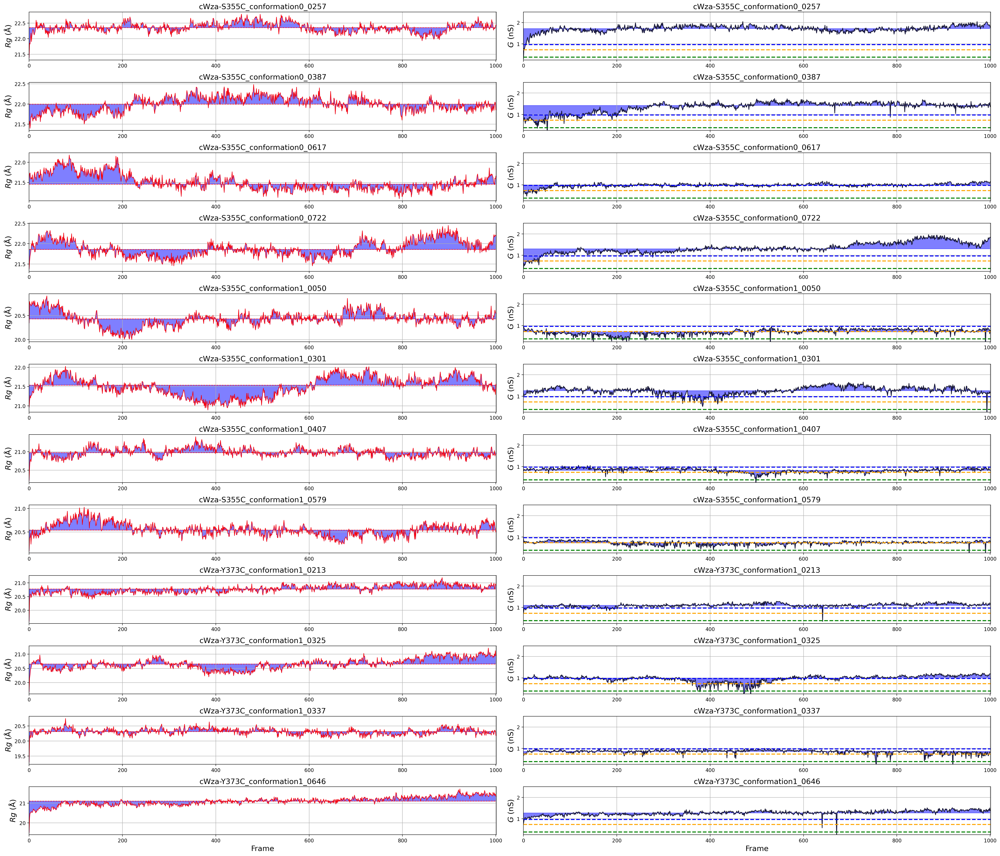

In [11]:
fig,ax = plt.subplots(len(selected_models),2, figsize=(28, 2*len(selected_models)),dpi=200)

for i in range(len(selected_models)):
    model_name = selected_models[i]
    Y = rg_results['backbone'][model_name][0]
    Y0 = median(Y)
    
    ax[i][0].plot(Y, color='red',lw=1)
    ax[i][0].fill_between(x=range(len(Y)),y1=Y0, y2=Y, color='blue',alpha=0.5)
    
    ax[i][0].axhline(Y0,linestyle='--',lw=1,color='red')
    ax[i][0].set_title(model_name,fontsize=15)
    ax[i][0].set_ylabel('$Rg$ (Å)',fontsize=15)
    ax[i][0].set_xlim(0,1001)
#     ax[i][0].set_ylim(20,22.5)
    ax[i][0].grid(True)

ax[i][0].set_xlabel('Frame',fontsize=15)


for i in range(len(selected_models)):
    model_name = selected_models[i]
    X = df_conductance[model_name]
    X0 = median(X)
    
    ax[i][1].plot(X, color='black', alpha=0.75, lw=1.5)
    ax[i][1].fill_between(x=range(len(X)),y1=X0, y2=X, color='blue',alpha=0.5)
    
    ax[i][1].axhline(y=0.38, label='L-state (EXPTL): 0.38 nS', color='green', linestyle='--', lw=2)
    ax[i][1].axhline(y=0.73, label='H-state, Y373C (EXPTL): 0.73 nS', color='orange', linestyle='--', lw=2)
    ax[i][1].axhline(y=0.97, label='H-state (EXPTL): 0.97 nS', color='blue', linestyle='--', lw=2)
    
    ax[i][1].set_ylabel('$G$ (nS)',fontsize=15)
    ax[i][1].set_title(model_name,fontsize=15)
    
    ax[i][1].set_xlim(0,1001)
    ax[i][1].set_ylim(0.25,2.5)
    ax[i][1].grid(True)
        
ax[i][1].set_xlabel('Frame',fontsize=15)
    
fig.tight_layout()
plt.show()

### All-atoms radius of gyration

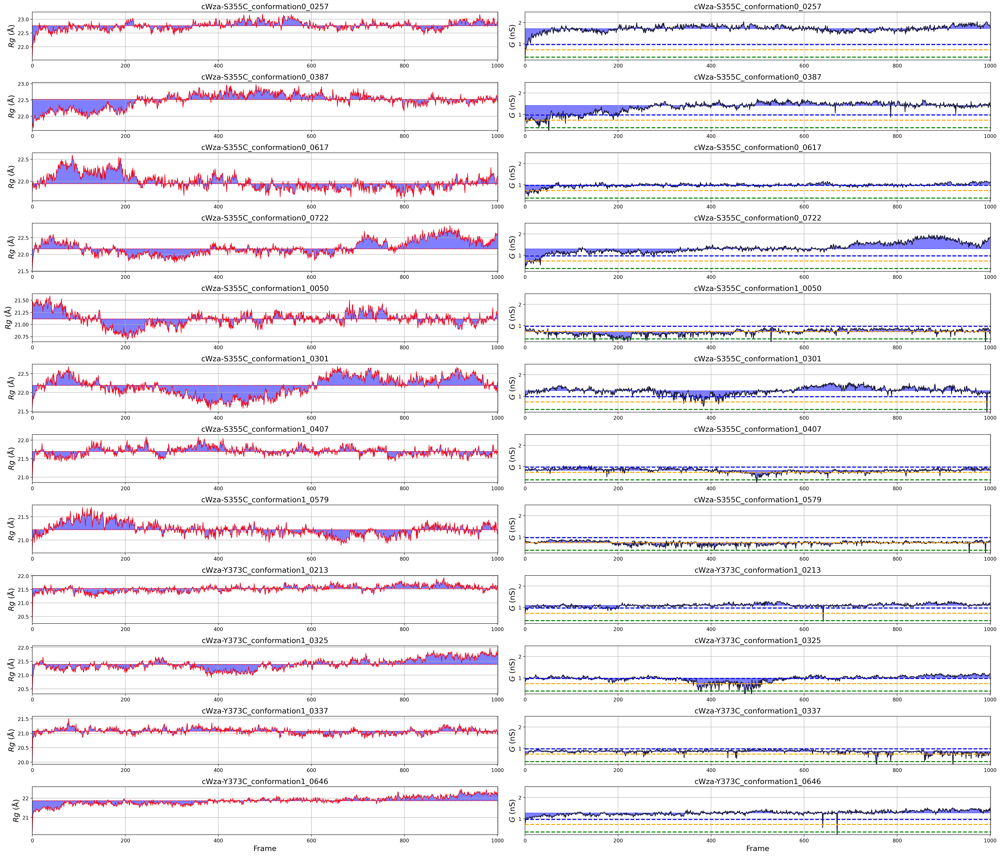

In [12]:
fig,ax = plt.subplots(len(selected_models),2, figsize=(28, 2*len(selected_models)),dpi=200)

for i in range(len(selected_models)):
    model_name = selected_models[i]
    Y = rg_results['allatoms'][model_name][0]
    Y0 = median(Y)
    
    ax[i][0].plot(Y, color='red',lw=1)
    ax[i][0].fill_between(x=range(len(Y)),y1=Y0, y2=Y, color='blue',alpha=0.5)
    
    ax[i][0].axhline(Y0,linestyle='--',lw=1,color='red')
    ax[i][0].set_title(model_name,fontsize=15)
    ax[i][0].set_ylabel('$Rg$ (Å)',fontsize=15)
    ax[i][0].set_xlim(0,1001)
#     ax[i][0].set_ylim(20,22.5)
    ax[i][0].grid(True)

ax[i][0].set_xlabel('Frame',fontsize=15)


for i in range(len(selected_models)):
    model_name = selected_models[i]
    X = df_conductance[model_name]
    X0 = median(X)
    
    ax[i][1].plot(X, color='black', alpha=0.75, lw=1.5)
    ax[i][1].fill_between(x=range(len(X)),y1=X0, y2=X, color='blue',alpha=0.5)
    
    ax[i][1].axhline(y=0.38, label='L-state (EXPTL): 0.38 nS', color='green', linestyle='--', lw=2)
    ax[i][1].axhline(y=0.73, label='H-state, Y373C (EXPTL): 0.73 nS', color='orange', linestyle='--', lw=2)
    ax[i][1].axhline(y=0.97, label='H-state (EXPTL): 0.97 nS', color='blue', linestyle='--', lw=2)
    
    ax[i][1].set_ylabel('$G$ (nS)',fontsize=15)
    ax[i][1].set_title(model_name,fontsize=15)
    
    ax[i][1].set_xlim(0,1001)
    ax[i][1].set_ylim(0.25,2.5)
    ax[i][1].grid(True)
        
ax[i][1].set_xlabel('Frame',fontsize=15)
    
fig.tight_layout()
plt.show()

## Figure: Version 2

Stacked

### Backbone radius of gyration

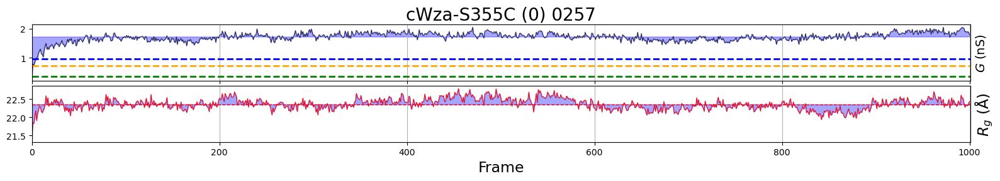

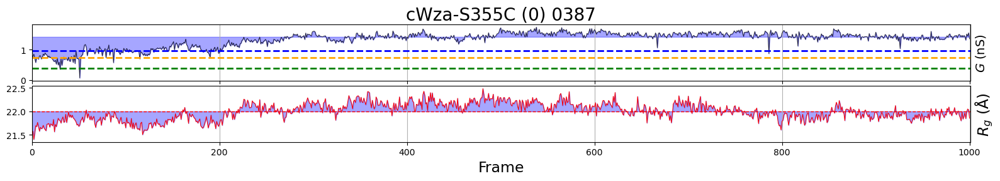

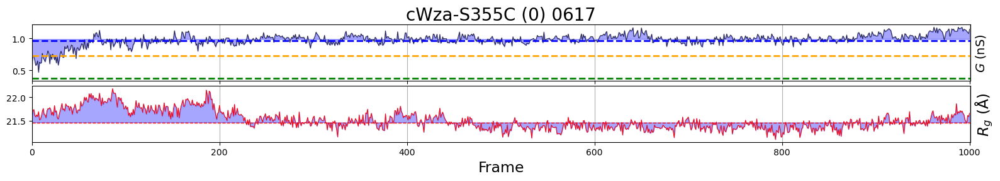

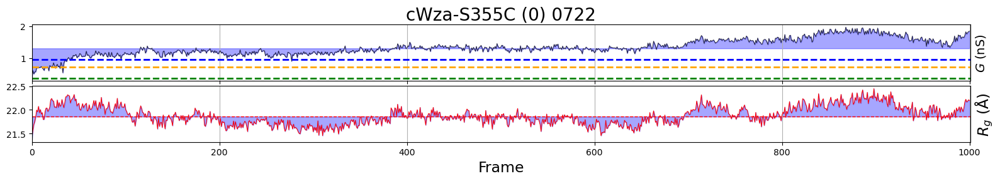

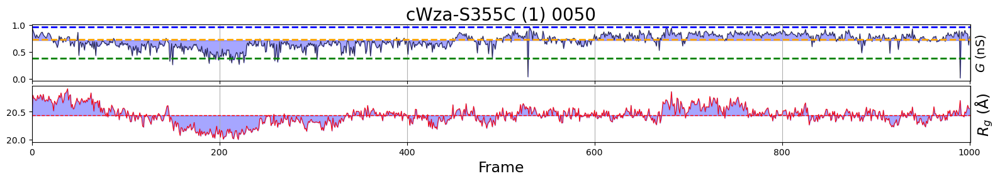

...

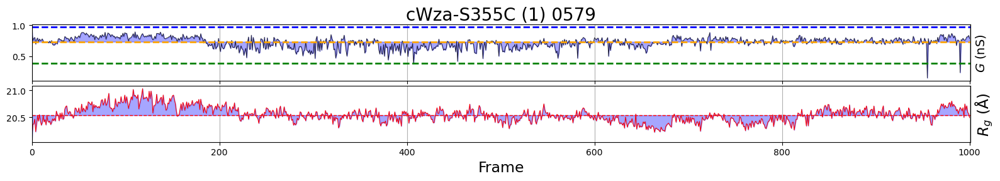

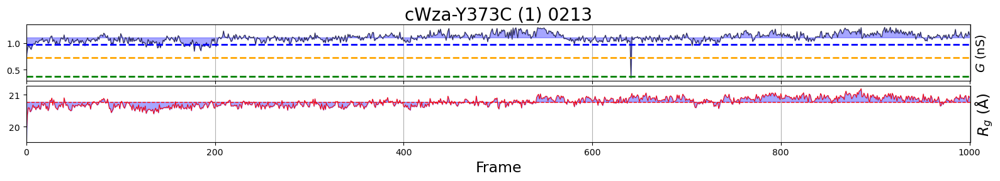

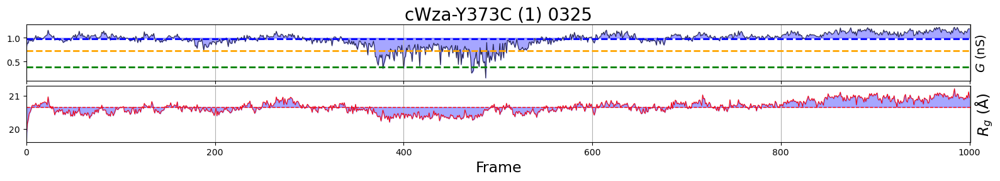

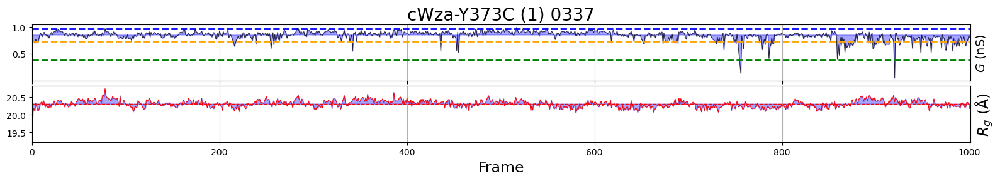

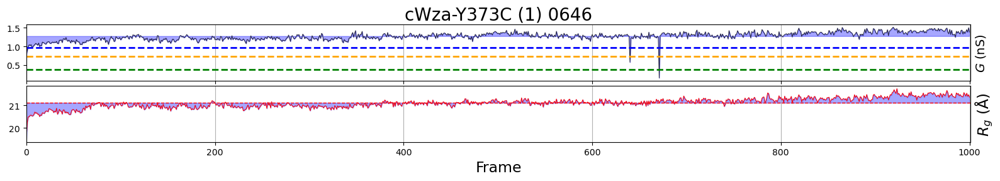

In [9]:
for i in range(len(selected_models)):
    fig,ax = plt.subplots(2,1,figsize=(16,3),sharex=True,dpi=100)
    
    model_name = selected_models[i]
    
    # Conductance timeseries plots
    X = df_conductance[model_name]; X0 = median(X)
    
    ax[0].plot(X, color='black',alpha=0.75, lw=0.75)
    ax[0].fill_between(x=range(len(X)),y1=X0, y2=X, color='blue',alpha=0.35)
    
    ax[0].axhline(y=0.38, label='L-state (EXPTL): 0.38 nS', color='green', linestyle='--', lw=2)
    ax[0].axhline(y=0.73, label='H-state, Y373C (EXPTL): 0.73 nS', color='orange', linestyle='--', lw=2)
    ax[0].axhline(y=0.97, label='H-state (EXPTL): 0.97 nS', color='blue', linestyle='--', lw=2)
    
    ax[0].set_ylabel('$G$ (nS)',fontsize=14)
    
    ax[0].set_xlim(0,1001)
    #ax[0].set_ylim(0.25,2.5)
    ax[0].yaxis.set_label_position("right")
    ax[0].xaxis.grid(True)
    
    mutant, conformation, number = model_name.split('_')
    title = mutant+' ('+conformation[-1]+') '+number
    ax[0].set_title(title,fontsize=20)
    
    # Radius of gyration timeseries plots
    Y = rg_results['backbone'][model_name][0]; Y0 = median(Y)
    
    ax[1].plot(Y, color='red',lw=0.75)
    ax[1].fill_between(x=range(len(Y)),y1=Y0, y2=Y, color='blue',alpha=0.35)
    
    ax[1].axhline(Y0,linestyle='--',lw=1,color='red')
        
    ax[1].set_ylabel('$R_{g}$ (Å)',fontsize=17)
    ax[1].set_xlim(0,1001)
    #ax[1].set_ylim(20,22.5)
    ax[1].yaxis.set_label_position("right")
    ax[1].xaxis.grid(True)
    ax[1].set_xlabel('Frame',fontsize=17)
    
    fig.tight_layout()
    fig.subplots_adjust(hspace=0.1)
    plt.show()

### All-atoms radius of gyration

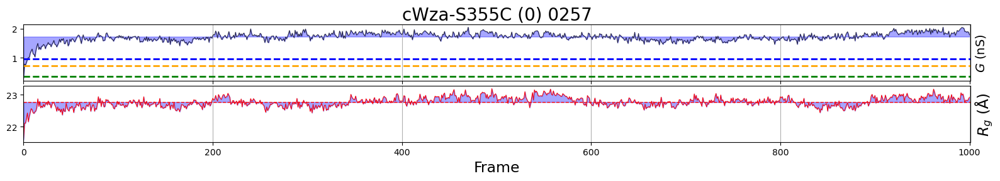

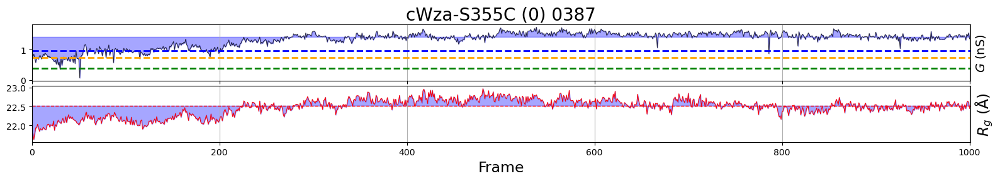

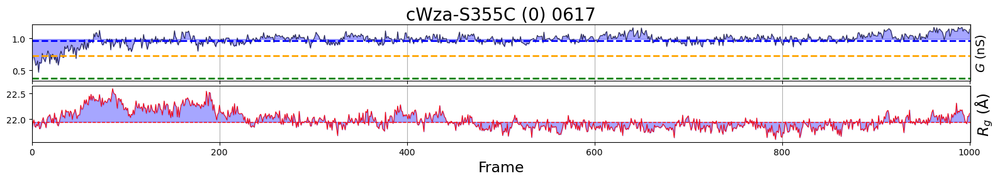

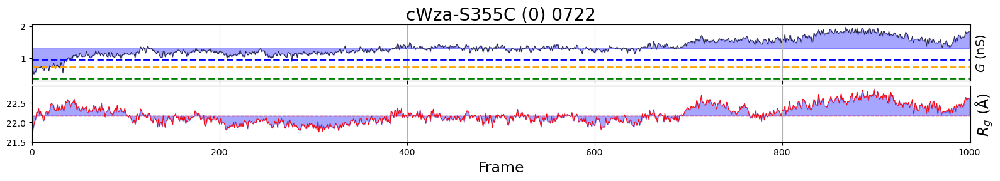

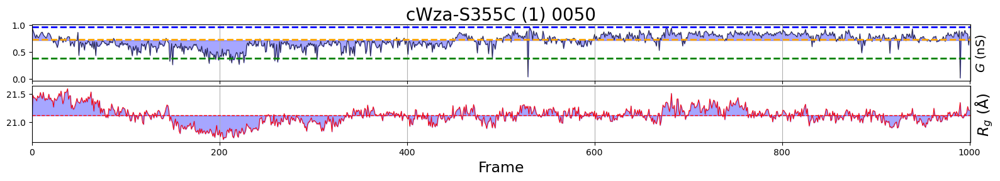

...

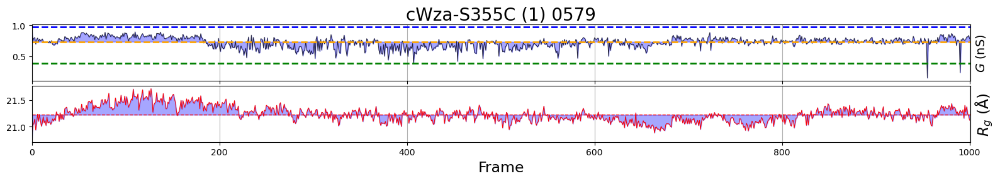

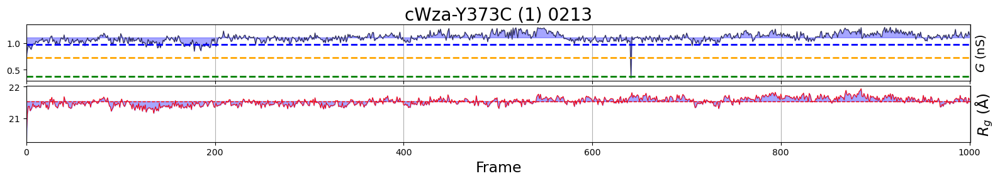

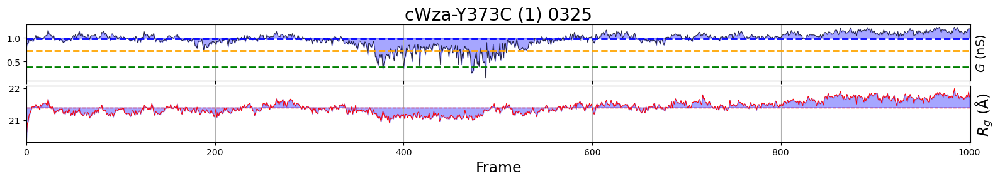

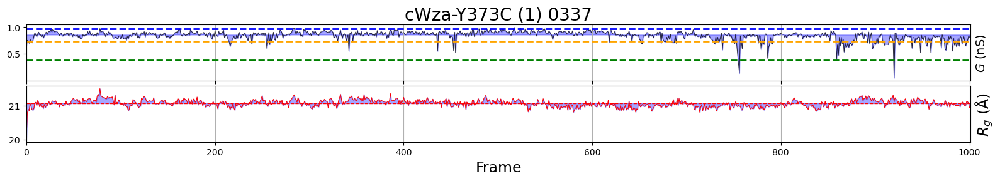

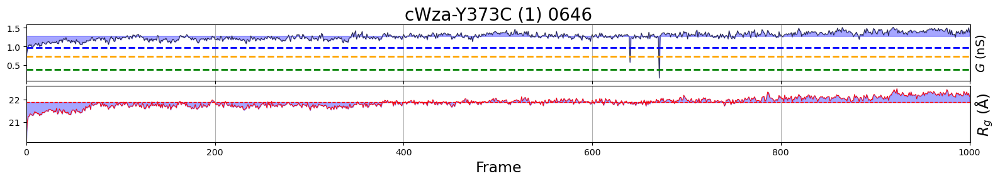

In [13]:
for i in range(len(selected_models)):
    fig,ax = plt.subplots(2,1,figsize=(16,3),sharex=True,dpi=100)
    
    model_name = selected_models[i]
    
    # Conductance timeseries plots
    X = df_conductance[model_name]; X0 = median(X)
    
    ax[0].plot(X, color='black',alpha=0.75, lw=0.75)
    ax[0].fill_between(x=range(len(X)),y1=X0, y2=X, color='blue',alpha=0.35)
    
    ax[0].axhline(y=0.38, label='L-state (EXPTL): 0.38 nS', color='green', linestyle='--', lw=2)
    ax[0].axhline(y=0.73, label='H-state, Y373C (EXPTL): 0.73 nS', color='orange', linestyle='--', lw=2)
    ax[0].axhline(y=0.97, label='H-state (EXPTL): 0.97 nS', color='blue', linestyle='--', lw=2)
    
    ax[0].set_ylabel('$G$ (nS)',fontsize=14)
    
    ax[0].set_xlim(0,1001)
    #ax[0].set_ylim(0.25,2.5)
    ax[0].yaxis.set_label_position("right")
    ax[0].xaxis.grid(True)
    
    mutant, conformation, number = model_name.split('_')
    title = mutant+' ('+conformation[-1]+') '+number
    ax[0].set_title(title,fontsize=20)
    
    # Radius of gyration timeseries plots
    Y = rg_results['allatoms'][model_name][0]; Y0 = median(Y)
    
    ax[1].plot(Y, color='red',lw=0.75)
    ax[1].fill_between(x=range(len(Y)),y1=Y0, y2=Y, color='blue',alpha=0.35)
    
    ax[1].axhline(Y0,linestyle='--',lw=1,color='red')
        
    ax[1].set_ylabel('$R_{g}$ (Å)',fontsize=17)
    ax[1].set_xlim(0,1001)
    #ax[1].set_ylim(20,22.5)
    ax[1].yaxis.set_label_position("right")
    ax[1].xaxis.grid(True)
    ax[1].set_xlabel('Frame',fontsize=17)
    
    fig.tight_layout()
    fig.subplots_adjust(hspace=0.1)
    plt.show()

# Intrachain Vs Interchain interactions in conductance stability

## Split trajectories by conductance stability

In [1]:
import pickle

In [2]:
filepath = 'data/Gpred_Rmin_timeseries_cleaned.pickle'
with open(filepath, 'rb') as fp:
    conductance_timeseries = pickle.load(fp)

In [3]:
X = conductance_timeseries

threshold = 0.09
f = lambda x: abs(x - x.mean()).mean() # absolute deviation

stable_models = [k for k,v in X.items() if f(v) <= threshold]
unstable_models = [k for k,v in X.items() if f(v) > threshold]

## H-bonds: split counts by interaction type

In [6]:
# Load essential libraries
import os
import pickle
import numpy as np
from numpy import NaN
import matplotlib.pyplot as plt

import pandas as pd
import seaborn as sns
from statistics import median

import MDAnalysis as mda

/homes/sanjuan/.local/lib/python3.8/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/homes/sanjuan/.local/lib/python3.8/site-packages/MDAnalysis/coordinates/TRJ.py:1209: DeprecationWarning: Please use `netcdf_file` from the `scipy.io` namespace, the `scipy.io.netcdf` namespace is deprecated.
  class NCDFPicklable(scipy.io.netcdf.netcdf_file):


In [6]:
def get_original_chain(x, peptide_length = 32):
    """
    Return the parent chain number in a homomeric peptide assembly for given a residue number
    """
    N = peptide_length
    if x%N == 0:
        return x//N -1
    else:
        return x//N

def get_original_resnum(x, peptide_length = 32):
    """
    Return the residue number in a homomeric peptide assembly for given a residue number
    """
    N = peptide_length
    if x%N == 0:
        return N
    else:
        return x%N

def find_resid(id, protein_atoms):
    """
    Return original residue number and chain annotations in a homomeric peptide assembly for a given atom id
    """
    f = get_original_chain
    g = get_original_resnum
    return [(str(f(atom.resid)), str(g(atom.resid)), atom.resname) for atom in protein_atoms if id == atom.id]

def intra_to_inter_hbond_counts(counts, u, protein_atoms):
    """
    Compute what percentage of the time intrachain and interchain sidechain H-bonds are found
    """
    interchain_counts = []
    intrachain_counts = []
    for donor, hydrogen, acceptor, count in counts:
        # get biopython objects
        d, h, a = u.atoms[donor], u.atoms[hydrogen], u.atoms[acceptor]
        # get parent labels
        donor_chain, donor_resn, donor_resname = find_resid(d.id, protein_atoms)[0]
        acceptor_chain, acceptor_resn, acceptor_resname = find_resid(a.id, protein_atoms)[0]
        if donor_chain == acceptor_chain:
            intrachain_counts.append(count)
        else:
            interchain_counts.append(count)

    intrachain_frequency = sum(intrachain_counts)/sum(counts.T[-1])
    interchain_frequency = sum(interchain_counts)/sum(counts.T[-1])
    
    return intrachain_frequency, interchain_frequency

In [7]:
dirnames = !ls -d data/cWza*_conformation*_[0-9][0-9][0-9][0-9]

In [10]:
leading_hbonds = [('28-ARG', '25-GLU'),
                  ('28-ARG', '32-THR'),
                  ('29-TYR', '25-GLU'),
                  ('18-THR', '22-ASP'),
                  ('6-TRP', '16-THR'),
                  ('21-HIS', '22-ASP'),
                  ('31-LYS', '32-THR'),
                  ('21-HIS', '25-GLU'),
                  ('28-ARG', '22-ASP'),
                  ('28-ARG', '26-THR')]

In [9]:
counts_data = {}
for model_dir in dirnames:
    model_name = model_dir.split('/')[-1]
    
    hbonds_filename =  os.path.join(model_dir,'md_100ns.hbonds.pickle')
    with open(hbonds_filename,'rb') as fp:
        HBA_data = pickle.load(fp)

    topology_filepath = os.path.join(model_dir, 'md_100ns.tpr')
    trajectory_filepath = os.path.join(model_dir, 'md_100ns.xtc')
    u = mda.Universe(topology_filepath, trajectory_filepath, in_memory=True)    
    protein_atoms = list(u.select_atoms("protein"))
    
    X = HBA_data
    Y = list()
    for key in leading_hbonds:
        if key in X.keys():
            counts = HBA_data[key]['ids']
            Y.append(np.array(intra_to_inter_hbond_counts(counts, u, protein_atoms)))
            print()
        else:
            Y.append((0.0, 0.0))
                     
    counts_data[model_name] = np.array(Y).T

Save data

### Breakdown by Hydrogen bond

In [13]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [9]:
leading_hbonds = [('28-ARG', '25-GLU'),
                  ('28-ARG', '32-THR'),
                  ('29-TYR', '25-GLU'),
                  ('18-THR', '22-ASP'),
                  ('6-TRP', '16-THR'),
                  ('21-HIS', '22-ASP'),
                  ('31-LYS', '32-THR'),
                  ('21-HIS', '25-GLU'),
                  ('28-ARG', '22-ASP'),
                  ('28-ARG', '26-THR')]

Read data

In [4]:
with open('data/intra_inter_hbonds_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

In [7]:
# define customed colourmap for mutants
colors = iter([plt.cm.Set2(i) for i in range(20)])
mutant_colors = {'cWza':next(colors),
                 'cWza-K375C':next(colors),
                 'cWza-S355C':next(colors),
                 'cWza-Y373C':next(colors)}

my_pal = [mutant_colors[model.split('_')[0]]  for model in counts_data.keys()]

aa_3to1 = {'CYS': 'C', 'ASP': 'D', 'SER': 'S', 'GLN': 'Q', 'LYS': 'K',
         'ILE': 'I', 'PRO': 'P', 'THR': 'T', 'PHE': 'F', 'ASN': 'N', 
         'GLY': 'G', 'HIS': 'H', 'LEU': 'L', 'ARG': 'R', 'TRP': 'W', 
         'ALA': 'A', 'VAL':'V', 'GLU': 'E', 'TYR': 'Y', 'MET': 'M'}

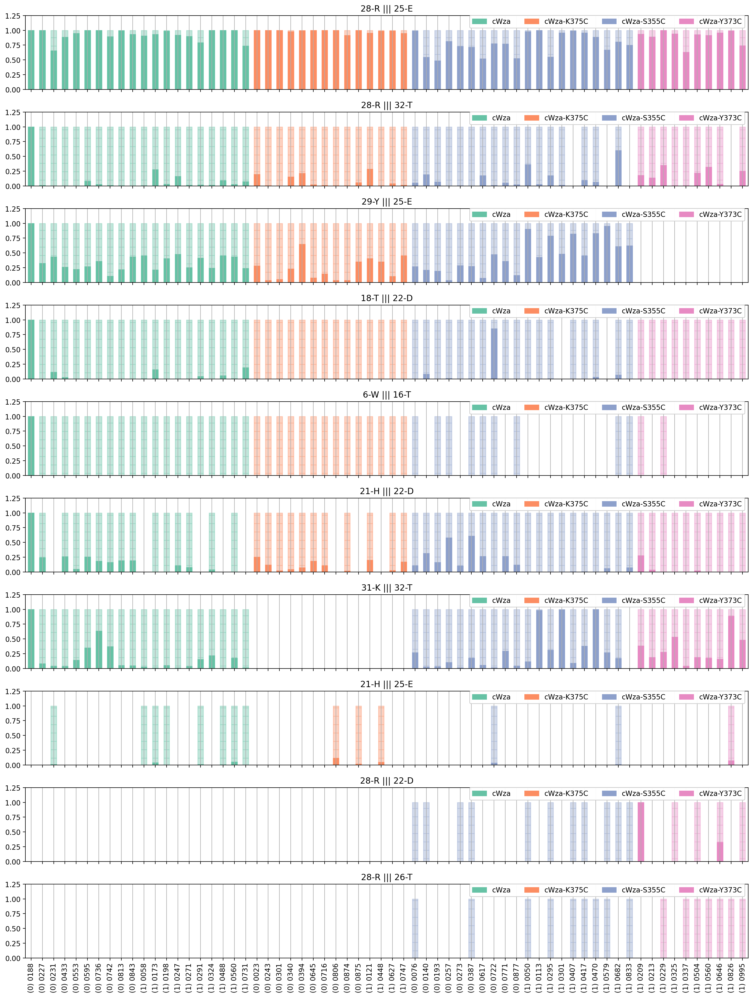

In [45]:
fig,axes=plt.subplots(len(leading_hbonds),1,figsize=(15,2*len(leading_hbonds)),sharex=True,dpi=200)

for i, hbond in enumerate(leading_hbonds):
    ax = axes[i]
    
    # Gather data per model and custom labels
    labels = []
    data = []
    for model_name in counts_data.keys():
        
        # Make model x-axis labels 
        mutant, conformation, number = model_name.split('_')
        x = ' ('+conformation[-1]+') '+number
        labels.append(x)

        # Gather data per model
        intra = counts_data[model_name][0][i]
        inter = counts_data[model_name][1][i]
        data.append([intra, inter])

    df = pd.DataFrame(np.array(data), columns=['intra','inter'])

    # Plot barplot data
    df.plot(kind='bar',stacked=True,ax = ax) 
        
    my_colors = my_pal+my_pal
    for k,bar in enumerate(ax.patches):
        if k <= len(ax.patches)/2:
            bar.set_hatch('')
            bar.set_alpha(1)
            bar.set_color(my_colors[k])
        else:
            bar.set_hatch('-')
            bar.set_alpha(0.4)
            bar.set_color(my_colors[k])

    # Custom appearance
    ax.set_xticklabels(labels, fontsize=10)

    # Custom title
    donor_resn, donor_resname = hbond[0].split("-")
    acceptor_resn, acceptor_resname = hbond[1].split("-")
    hbond_title = donor_resn+'-'+aa_3to1[donor_resname]+' ||| '+acceptor_resn+'-'+aa_3to1[acceptor_resname]
    ax.set_title(hbond_title)
    ax.set_ylim(0,1.25)
    
    # Legend box settings
    import matplotlib.patches as mpatches
    patches = []
    for m in mutant_colors.keys():
        p = mpatches.Patch(color=mutant_colors[m], label=m)
        patches.append(p)
    

    # Custom legend box
    legend1 = ax.legend(loc='upper right',
                        ncols=4,
                        handles = patches,
                        bbox_to_anchor=[1.0, 1.05])
    
    ax.add_artist(legend1) # add first legendbox
    ax.xaxis.grid(True)
    
fig.tight_layout()    
plt.show()

### Model averages: Stable Vs Unstable models

Read data

In [52]:
with open('data/intra_inter_hbonds_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

In [53]:
# Load essential libraries
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt

import pandas as pd

Read data

In [54]:
with open('data/intra_inter_hbonds_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

In [55]:
leading_hbonds = [('28-ARG', '25-GLU'),
                  ('28-ARG', '32-THR'),
                  ('29-TYR', '25-GLU'),
                  ('18-THR', '22-ASP'),
                  ('6-TRP', '16-THR'),
                  ('21-HIS', '22-ASP'),
                  ('31-LYS', '32-THR'),
                  ('21-HIS', '25-GLU'),
                  ('28-ARG', '22-ASP'),
                  ('28-ARG', '26-THR')]

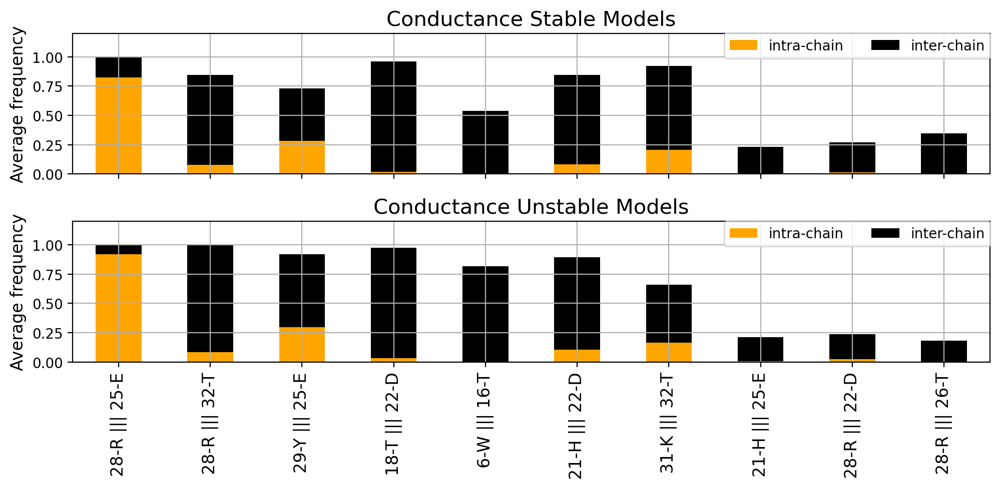

In [56]:
fig,axes = plt.subplots(2,1,figsize=(10,5),sharex=True,sharey=True,dpi=200)
###########################################################
S = stable_models
###########################################################
mean_counts_intrachain = np.array([counts_data[model_name][0] for model_name in S]).mean(axis=0)
mean_counts_interchain = np.array([counts_data[model_name][1] for model_name in S]).mean(axis=0)
data = pd.DataFrame(np.array([mean_counts_intrachain, mean_counts_interchain]).T, 
                    columns=['intra-chain','inter-chain'])

ax = axes[0]
data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)

# Custom legend box
ax.legend(loc='upper right',
          bbox_to_anchor=(1.008, 1.05),
          fontsize=10,
          ncols=2)

# Other settings
ax.set_ylabel('Average frequency', fontsize=12)
ax.set_title('Conductance Stable Models', fontsize=15)
ax.set_ylim(0,1.2)
ax.grid("True")

###########################################################
S = unstable_models
###########################################################
mean_counts_intrachain = np.array([counts_data[model_name][0] for model_name in S]).mean(axis=0)
mean_counts_interchain = np.array([counts_data[model_name][1] for model_name in S]).mean(axis=0)
data = pd.DataFrame(np.array([mean_counts_intrachain, mean_counts_interchain]).T, 
                    columns=['intra-chain','inter-chain'])

ax = axes[1]
data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)

# Custom x-axis labels
aa_3to1 = {'CYS': 'C', 'ASP': 'D', 'SER': 'S', 'GLN': 'Q', 'LYS': 'K',
         'ILE': 'I', 'PRO': 'P', 'THR': 'T', 'PHE': 'F', 'ASN': 'N', 
         'GLY': 'G', 'HIS': 'H', 'LEU': 'L', 'ARG': 'R', 'TRP': 'W', 
         'ALA': 'A', 'VAL':'V', 'GLU': 'E', 'TYR': 'Y', 'MET': 'M'}

labels = []
for hbond in leading_hbonds:    
    donor_resn, donor_resname = hbond[0].split("-")
    acceptor_resn, acceptor_resname = hbond[1].split("-")
    hbond_label = donor_resn+'-'+aa_3to1[donor_resname]+' ||| '+acceptor_resn+'-'+aa_3to1[acceptor_resname]
    labels.append(hbond_label)

ax.set_xticklabels(labels, fontsize=12)

# Custom legend box
ax.legend(loc='upper right',
          bbox_to_anchor=(1.008, 1.05),
          fontsize=10,
          ncols=2)

# Other settings
ax.set_ylabel('Average frequency', fontsize=12)
ax.set_title('Conductance Unstable Models', fontsize=15)
ax.set_ylim(0,1.2)
ax.grid("True")

fig.tight_layout()

plt.show()

### Breakdown by model: Stable models

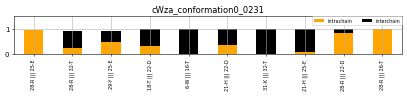

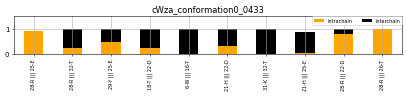

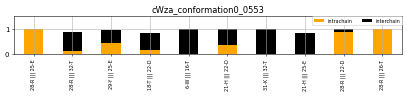

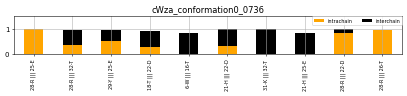

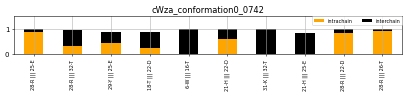

...

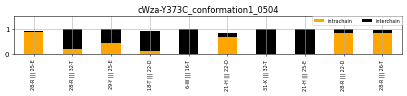

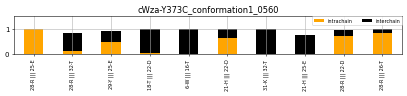

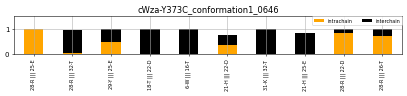

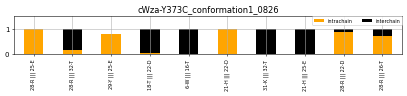

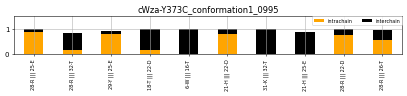

In [27]:
# Custom x-axis labels
aa_3to1 = {'CYS': 'C', 'ASP': 'D', 'SER': 'S', 'GLN': 'Q', 'LYS': 'K',
     'ILE': 'I', 'PRO': 'P', 'THR': 'T', 'PHE': 'F', 'ASN': 'N', 
     'GLY': 'G', 'HIS': 'H', 'LEU': 'L', 'ARG': 'R', 'TRP': 'W', 
     'ALA': 'A', 'VAL':'V', 'GLU': 'E', 'TYR': 'Y', 'MET': 'M'}

labels = []
for hbond in leading_hbonds:    
    donor_resn, donor_resname = hbond[0].split("-")
    acceptor_resn, acceptor_resname = hbond[1].split("-")
    hbond_label = donor_resn+'-'+aa_3to1[donor_resname]+' ||| '+acceptor_resn+'-'+aa_3to1[acceptor_resname]
    labels.append(hbond_label)

S = stable_models
for model_name in S:
    fig,axes = plt.subplots(1,1,figsize=(10,1),dpi=50)
    data = pd.DataFrame(np.array([counts_data[model_name][0], counts_data[model_name][1]]).T, 
                    columns=['intrachain','interchain'])
    
    ax = axes
    data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)
    
    ax.set_xticklabels(labels, fontsize=7)
    ax.set_ylim(0,1.5)
    ax.set_title(model_name)
    ax.grid("True")
    
    # Custom legend box
    ax.legend(loc='upper right',
              bbox_to_anchor=(1.008, 1.05),
              fontsize=7,
              ncols=2)

    plt.show()

### Breakdown by model: Unstable models

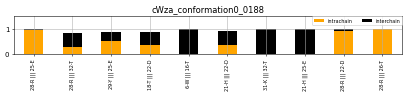

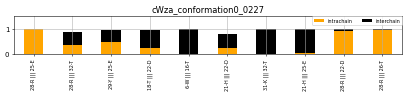

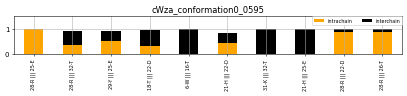

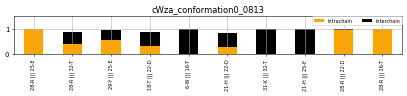

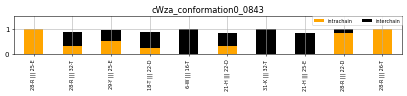

...

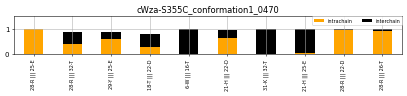

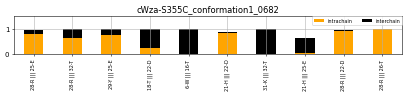

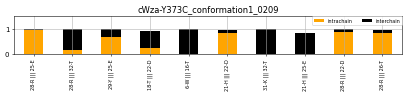

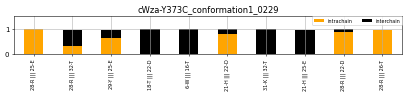

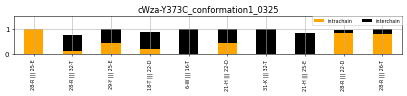

In [28]:
# Custom x-axis labels
aa_3to1 = {'CYS': 'C', 'ASP': 'D', 'SER': 'S', 'GLN': 'Q', 'LYS': 'K',
     'ILE': 'I', 'PRO': 'P', 'THR': 'T', 'PHE': 'F', 'ASN': 'N', 
     'GLY': 'G', 'HIS': 'H', 'LEU': 'L', 'ARG': 'R', 'TRP': 'W', 
     'ALA': 'A', 'VAL':'V', 'GLU': 'E', 'TYR': 'Y', 'MET': 'M'}

labels = []
for hbond in leading_hbonds:    
    donor_resn, donor_resname = hbond[0].split("-")
    acceptor_resn, acceptor_resname = hbond[1].split("-")
    hbond_label = donor_resn+'-'+aa_3to1[donor_resname]+' ||| '+acceptor_resn+'-'+aa_3to1[acceptor_resname]
    labels.append(hbond_label)

S = unstable_models
for model_name in S:
    fig,axes = plt.subplots(1,1,figsize=(10,1),dpi=50)
    data = pd.DataFrame(np.array([counts_data[model_name][0], counts_data[model_name][1]]).T, 
                    columns=['intrachain','interchain'])
    
    ax = axes
    data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)
    
    ax.set_xticklabels(labels, fontsize=7)
    ax.set_ylim(0,1.5)
    ax.set_title(model_name)
    ax.grid("True")
    
    # Custom legend box
    ax.legend(loc='upper right',
              bbox_to_anchor=(1.008, 1.05),
              fontsize=7,
              ncols=2)

    plt.show()

## Noncovalent contacts: split counts by interaction type

In [1]:
import os
import json
import pickle
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
def get_original_chain(x, peptide_length = 32):
    N = peptide_length
    if x%N == 0:
        return x//N -1
    else:
        return x//N

def get_original_resnum(x, peptide_length = 32):
    N = peptide_length
    if x%N == 0:
        return N
    else:
        return x%N
    
def intra_to_inter_contacts_counts(contacts_data):
    
    minimum_contacts = []
    for contact in set(contacts_data.keys()):
        i, j = contact
        contact_new = (get_original_resnum(i), get_original_resnum(j))
        if contact_new[::-1] not in minimum_contacts:
            minimum_contacts.append(contact_new)

    contacts_grouped = {k:[] for k in minimum_contacts}
    interchain_counts = {k:[] for k in minimum_contacts}
    intrachain_counts = {k:[] for k in minimum_contacts}

    for key in contacts_data.keys():
        i, j = key
        key_new = (get_original_resnum(i), get_original_resnum(j))
        chain_i, chain_j = (get_original_chain(i), get_original_chain(j))

        try:
            contacts_grouped[key_new].append(contacts_data[key])

        except KeyError:
            contacts_grouped[key_new[::-1]].append(contacts_data[key])

        if chain_i == chain_j:
            try:
                intrachain_counts[key_new].append(contacts_data[key] > 0)
            except:
                intrachain_counts[key_new[::-1]].append(contacts_data[key] > 0)

        elif chain_i != chain_j:
            try:
                interchain_counts[key_new].append(contacts_data[key] > 0)
            except KeyError:
                interchain_counts[key_new[::-1]].append(contacts_data[key] > 0)

    intrachain_frequency = {respair: np.sum(intrachain_counts[respair])/np.sum(np.array(contacts_grouped[respair]) > 0) for respair in intrachain_counts.keys() if len(intrachain_counts[respair]) > 0}
    interchain_frequency = {respair: np.sum(interchain_counts[respair])/np.sum(np.array(contacts_grouped[respair]) > 0) for respair in interchain_counts.keys() if len(interchain_counts[respair]) > 0}

    return contacts_grouped, intrachain_frequency, interchain_frequency

In [3]:
leading_contacts = list(pd.read_csv('data/df_md_dominant_contacts.csv').index)
leading_contacts = [tuple(json.loads(x)) for x in leading_contacts]

In [4]:
dirnames = !ls -d data/cWza*_conformation*_[0-9][0-9][0-9][0-9]

In [5]:
counts_data = {}
for outdir in dirnames:
    model_name = outdir.split('/')[-1]
    
    with open(os.path.join(outdir, "md_100ns.contacts.pickle"),'rb') as fp:
        X = pickle.load(fp)
        
    contacts_data = {k:X[k] for k,v in X.items()}
    
    _, Y1, Y2 = intra_to_inter_contacts_counts(contacts_data)
    intrachain_frequency = Y1
    interchain_frequency = Y2
    
    counts_data_intrachain = []
    for respair in leading_contacts:
        if (respair in intrachain_frequency.keys()) or (respair[::-1] in intrachain_frequency.keys()):
            try:
                counts_data_intrachain.append(intrachain_frequency[respair])
            except KeyError:
                counts_data_intrachain.append(intrachain_frequency[respair[::-1]])

        else:
            counts_data_intrachain.append(0.0)
    
    counts_data_interchain = []
    for respair in leading_contacts:
        if (respair in interchain_frequency.keys()) or (respair[::-1] in interchain_frequency.keys()):
            try:
                counts_data_interchain.append(interchain_frequency[respair])
            except KeyError:
                counts_data_interchain.append(interchain_frequency[respair[::-1]])

        else:
            counts_data_interchain.append(0.0)

    counts_data[model_name] = np.array([counts_data_intrachain, counts_data_interchain])

Save data

In [6]:
with open('data/intra_inter_contacts_counts.pickle', 'wb') as fp:
    pickle.dump(counts_data, fp)

### Breakdown by Noncovalent contact

Read data

In [2]:
with open('data/intra_inter_contacts_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

In [3]:
leading_contacts = list(pd.read_csv('data/df_md_dominant_contacts.csv').index)
leading_contacts = [tuple(json.loads(x)) for x in leading_contacts]

In [4]:
# define customed colourmap for mutants
colors = iter([plt.cm.Set2(i) for i in range(20)])
mutant_colors = {'cWza':next(colors),
                 'cWza-K375C':next(colors),
                 'cWza-S355C':next(colors),
                 'cWza-Y373C':next(colors)}

my_pal = [mutant_colors[model.split('_')[0]]  for model in counts_data.keys()]

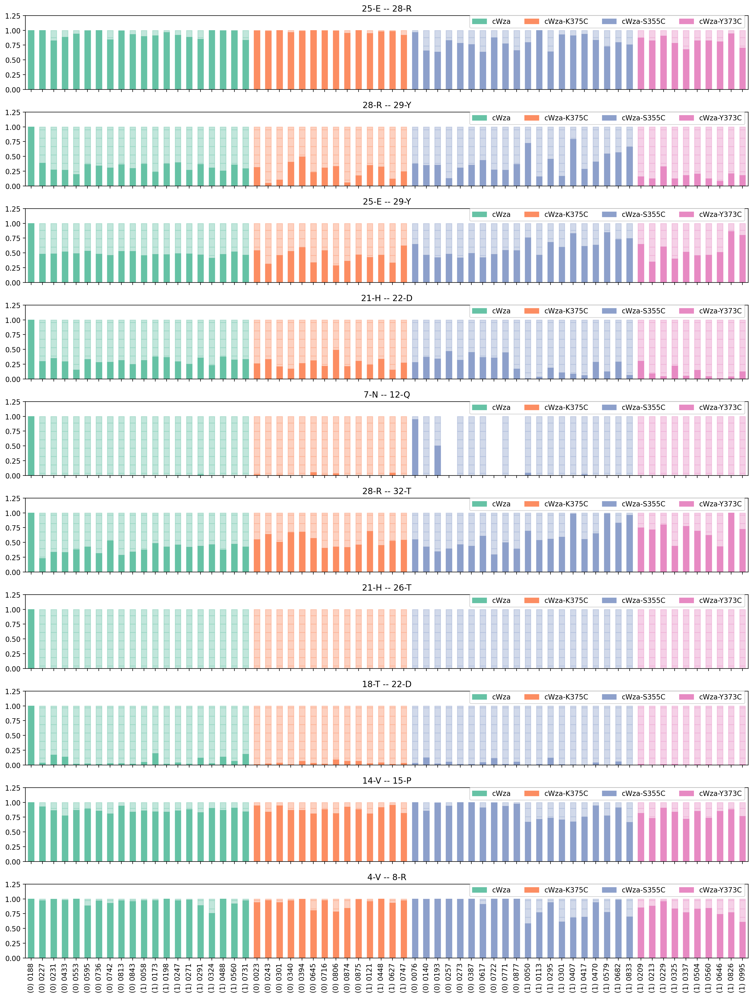

In [7]:
fig,axes=plt.subplots(len(leading_contacts),1,figsize=(15,2*len(leading_contacts)),sharex=True,dpi=200)

for i, contact in enumerate(leading_contacts):
    ax = axes[i]
    
    # Gather data per model and custom labels
    labels = []
    data = []
    for model_name in counts_data.keys():
        
        # Make model x-axis labels 
        mutant, conformation, number = model_name.split('_')
        x = ' ('+conformation[-1]+') '+number
        labels.append(x)

        # Gather data per model
        intra = counts_data[model_name][0][i]
        inter = counts_data[model_name][1][i]
        data.append([intra, inter])

    df = pd.DataFrame(np.array(data), columns=['intra','inter'])

    # Plot barplot data
    df.plot(kind='bar',stacked=True,ax = ax) 
        
    my_colors = my_pal+my_pal
    for k,bar in enumerate(ax.patches):
        if k <= len(ax.patches)/2:
            bar.set_hatch('')
            bar.set_alpha(1)
            bar.set_color(my_colors[k])
        else:
            bar.set_hatch('-')
            bar.set_alpha(0.4)
            bar.set_color(my_colors[k])

    # Custom appearance
    ax.set_xticklabels(labels, fontsize=10)

    # Custom title
    seq = 'APLVRWNRVISQLVPTITGVHDLTETVRYIKTWPN'    
    resn_A = contact[0]
    resn_B = contact[1]
    contact_title = str(resn_A)+'-'+seq[resn_A-1]+' -- '+str(resn_B)+'-'+seq[resn_B-1]
    ax.set_title(contact_title)
    
    ax.set_ylim(0,1.25)
    
    # Legend box settings
    import matplotlib.patches as mpatches
    patches = []
    for m in mutant_colors.keys():
        p = mpatches.Patch(color=mutant_colors[m], label=m)
        patches.append(p)
    

    # Custom legend box
    ax.legend(loc='upper right',
              ncols=4,
              handles = patches,
              bbox_to_anchor=[1.0, 1.05])
    
fig.tight_layout()
plt.show()

### Model averages: Stable Vs Unstable models

Read data

In [76]:
with open('data/intra_inter_contacts_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

In [77]:
leading_contacts = list(pd.read_csv('data/df_md_dominant_contacts.csv').index)
leading_contacts = [tuple(json.loads(x)) for x in leading_contacts]

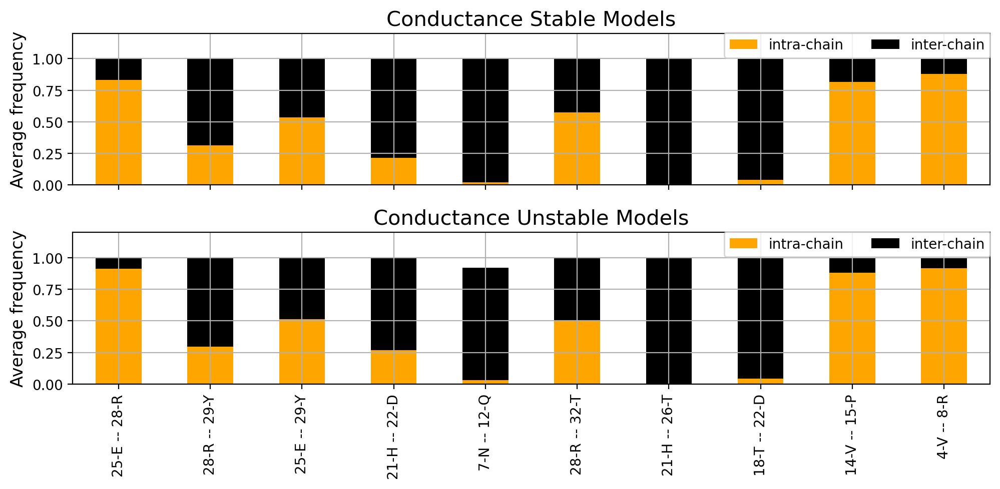

In [78]:
fig,axes = plt.subplots(2,1,figsize=(10,5),sharex=True,sharey=True,dpi=200)
###########################################################
S = stable_models
###########################################################
mean_counts_intrachain = np.array([counts_data[model_name][0] for model_name in S]).mean(axis=0)
mean_counts_interchain = np.array([counts_data[model_name][1] for model_name in S]).mean(axis=0)
data = pd.DataFrame(np.array([mean_counts_intrachain, mean_counts_interchain]).T, 
                    columns=['intra-chain','inter-chain'])

ax = axes[0]
data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)

# Custom legend box
ax.legend(loc='upper right',
          bbox_to_anchor=(1.008, 1.05),
          fontsize=10,
          ncols=2)

# Other settings
ax.set_ylabel('Average frequency', fontsize=12)
ax.set_title('Conductance Stable Models', fontsize=15)
ax.set_ylim(0,1.2)
ax.grid("True")

###########################################################
S = unstable_models
###########################################################
mean_counts_intrachain = np.array([counts_data[model_name][0] for model_name in S]).mean(axis=0)
mean_counts_interchain = np.array([counts_data[model_name][1] for model_name in S]).mean(axis=0)
data = pd.DataFrame(np.array([mean_counts_intrachain, mean_counts_interchain]).T, 
                    columns=['intra-chain','inter-chain'])

ax = axes[1]
data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)

# Custom x-axis labels
contacts_labels = []
seq = 'APLVRWNRVISQLVPTITGVHDLTETVRYIKTWPN'
for contact in leading_contacts:
    resn_A = contact[0]
    resn_B = contact[1]
    label = str(resn_A)+'-'+seq[resn_A-1]+' -- '+str(resn_B)+'-'+seq[resn_B-1]
    contacts_labels.append(label)

ax.set_xticklabels(contacts_labels, rotation=90)

# Custom legend box
ax.legend(loc='upper right',
          bbox_to_anchor=(1.008, 1.05),
          fontsize=10,
          ncols=2)

# Other settings
ax.set_ylabel('Average frequency', fontsize=12)
ax.set_title('Conductance Unstable Models', fontsize=15)
ax.set_ylim(0,1.2)
ax.grid("True")

fig.tight_layout()

plt.show()

### Breakdown by model: Stable models

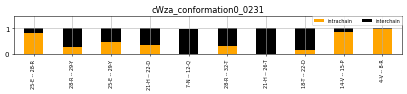

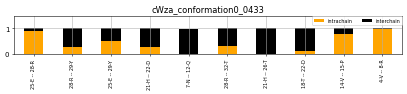

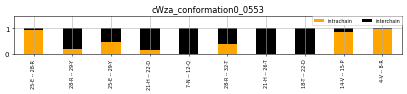

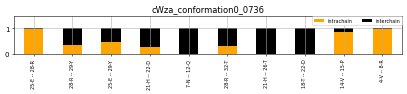

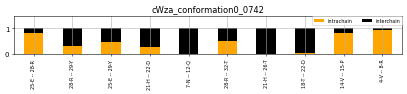

...

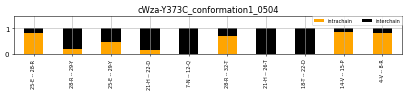

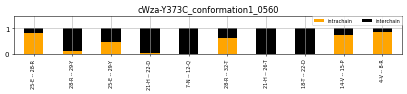

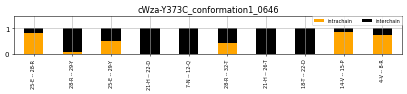

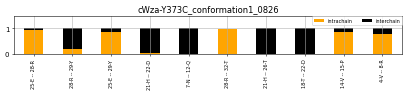

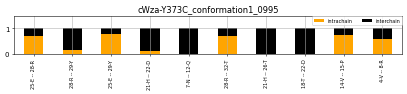

In [18]:
# Custom x-axis labels
contacts_labels = []
seq = 'APLVRWNRVISQLVPTITGVHDLTETVRYIKTWPN'
for contact in leading_contacts:
    resn_A = contact[0]
    resn_B = contact[1]
    label = str(resn_A)+'-'+seq[resn_A-1]+' -- '+str(resn_B)+'-'+seq[resn_B-1]
    contacts_labels.append(label)


S = stable_models
for model_name in S:
    fig,axes = plt.subplots(1,1,figsize=(10,1),dpi=50)
    data = pd.DataFrame(np.array([counts_data[model_name][0], counts_data[model_name][1]]).T, 
                    columns=['intrachain','interchain'])
    
    ax = axes
    data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)
    
    ax.set_xticklabels(contacts_labels, fontsize=7)
    ax.set_ylim(0,1.5)
    ax.set_title(model_name)
    ax.grid("True")
    
    # Custom legend box
    ax.legend(loc='upper right',
              bbox_to_anchor=(1.008, 1.05),
              fontsize=7,
              ncols=2)

    plt.show()

### Breakdown by model: Unstable models

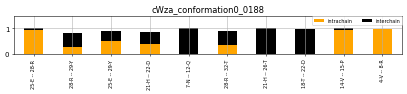

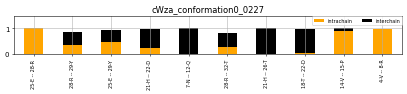

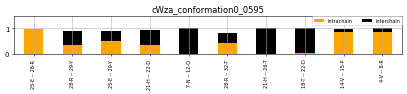

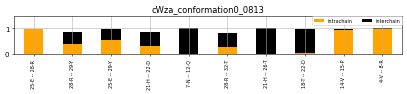

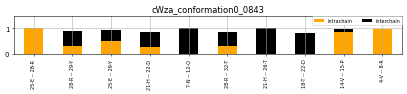

...

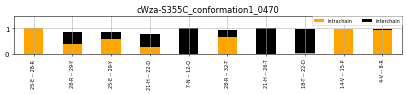

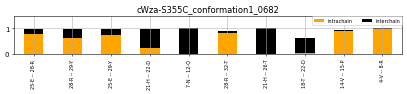

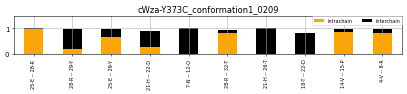

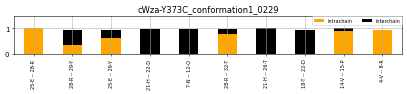

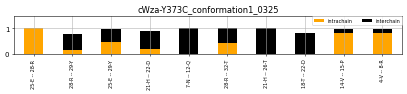

In [32]:
# Custom x-axis labels
contacts_labels = []
seq = 'APLVRWNRVISQLVPTITGVHDLTETVRYIKTWPN'
for contact in leading_contacts:
    resn_A = contact[0]
    resn_B = contact[1]
    label = str(resn_A)+'-'+seq[resn_A-1]+' -- '+str(resn_B)+'-'+seq[resn_B-1]
    contacts_labels.append(label)


S = unstable_models
for model_name in S:
    fig,axes = plt.subplots(1,1,figsize=(10,1),dpi=50)
    data = pd.DataFrame(np.array([counts_data[model_name][0], counts_data[model_name][1]]).T, 
                    columns=['intrachain','interchain'])
    
    ax = axes
    data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)
    
    ax.set_xticklabels(contacts_labels, fontsize=7)
    ax.set_ylim(0,1.5)
    ax.set_title(model_name)
    ax.grid("True")
    
    # Custom legend box
    ax.legend(loc='upper right',
              bbox_to_anchor=(1.008, 1.05),
              fontsize=7,
              ncols=2)

    plt.show()

# Selected models visiting L-state

In [1]:
selected_models = ['cWza-S355C_conformation0_0257',
                   'cWza-S355C_conformation0_0387',
                   'cWza-S355C_conformation0_0617',
                   'cWza-S355C_conformation0_0722',
                   'cWza-S355C_conformation1_0050',
                   'cWza-S355C_conformation1_0301',
                   'cWza-S355C_conformation1_0407',
                   'cWza-S355C_conformation1_0579',
                   'cWza-Y373C_conformation1_0213',
                   'cWza-Y373C_conformation1_0325',
                   'cWza-Y373C_conformation1_0337',
                   'cWza-Y373C_conformation1_0646']

## Hydrogen bond heatmaps by model

In [5]:
selected_models = ['cWza-S355C_conformation0_0257',
                   'cWza-S355C_conformation0_0387',
                   'cWza-S355C_conformation0_0617',
                   'cWza-S355C_conformation0_0722',
                   'cWza-S355C_conformation1_0050',
                   'cWza-S355C_conformation1_0301',
                   'cWza-S355C_conformation1_0407',
                   'cWza-S355C_conformation1_0579',
                   'cWza-Y373C_conformation1_0213',
                   'cWza-Y373C_conformation1_0325',
                   'cWza-Y373C_conformation1_0337',
                   'cWza-Y373C_conformation1_0646']

In [2]:
import os
import pickle
import numpy as np
from numpy import NaN

import pandas as pd
import seaborn as sns
from statistics import median

import MDAnalysis as mda
from MDAnalysis.analysis.base import (AnalysisBase,
                                      AnalysisFromFunction,
                                      analysis_class)

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

/homes/sanjuan/.local/lib/python3.8/site-packages/MDAnalysis/coordinates/chemfiles.py:108: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  MIN_CHEMFILES_VERSION = LooseVersion("0.9")
/homes/sanjuan/.local/lib/python3.8/site-packages/MDAnalysis/coordinates/TRJ.py:1209: DeprecationWarning: Please use `netcdf_file` from the `scipy.io` namespace, the `scipy.io.netcdf` namespace is deprecated.
  class NCDFPicklable(scipy.io.netcdf.netcdf_file):


In [3]:
leading_hbonds = [('28-ARG', '25-GLU'),
                  ('28-ARG', '32-THR'),
                  ('29-TYR', '25-GLU'),
                  ('18-THR', '22-ASP'),
                  ('6-TRP', '16-THR'),
                  ('21-HIS', '22-ASP'),
                  ('31-LYS', '32-THR'),
                  ('21-HIS', '25-GLU'),
                  ('28-ARG', '22-ASP'),
                  ('28-ARG', '26-THR')]

In [4]:
def get_original_chain(x, peptide_length = 32):
    """
    Return the parent chain number in a homomeric peptide assembly for given a residue number
    """
    N = peptide_length
    if x%N == 0:
        return x//N -1
    else:
        return x//N

def get_original_resnum(x, peptide_length = 32):
    """
    Return the residue number in a homomeric peptide assembly for given a residue number
    """
    N = peptide_length
    if x%N == 0:
        return N
    else:
        return x%N

def find_resid(id, protein_atoms):
    """
    Return original residue number and chain annotations in a homomeric peptide assembly for a given atom id
    """
    f = get_original_chain
    g = get_original_resnum
    return [(str(f(atom.resid)), str(g(atom.resid)), atom.resname) for atom in protein_atoms if id == atom.id]

def intra_to_inter_hbond_counts(counts, u, protein_atoms):
    """
    Compute what percentage of the time intrachain and interchain sidechain H-bonds are found
    """
    interchain_counts = []
    intrachain_counts = []
    for donor, hydrogen, acceptor, count in counts:
        # get biopython objects
        d, h, a = u.atoms[donor], u.atoms[hydrogen], u.atoms[acceptor]
        # get parent labels
        donor_chain, donor_resn, donor_resname = find_resid(d.id, protein_atoms)[0]
        acceptor_chain, acceptor_resn, acceptor_resname = find_resid(a.id, protein_atoms)[0]
        if donor_chain == acceptor_chain:
            intrachain_counts.append(count)
        else:
            interchain_counts.append(count)

    intrachain_frequency = sum(intrachain_counts)/sum(counts.T[-1])
    interchain_frequency = sum(interchain_counts)/sum(counts.T[-1])
    
    return intrachain_frequency, interchain_frequency

In [5]:
selected_models[0]

'cWza-S355C_conformation0_0257'

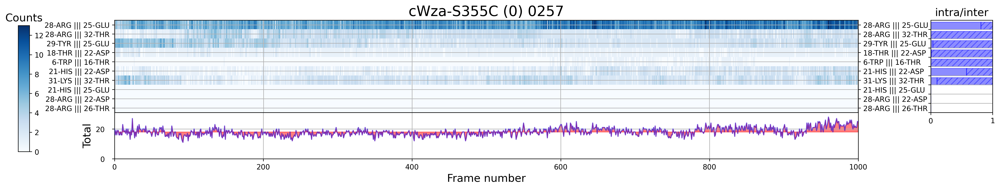

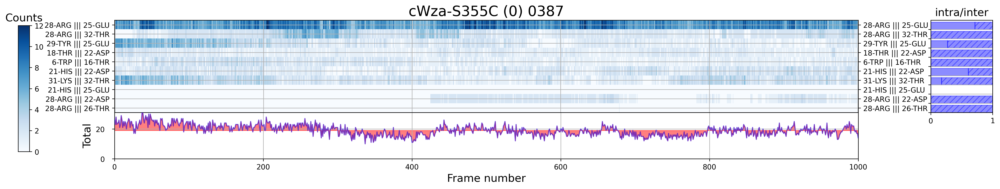

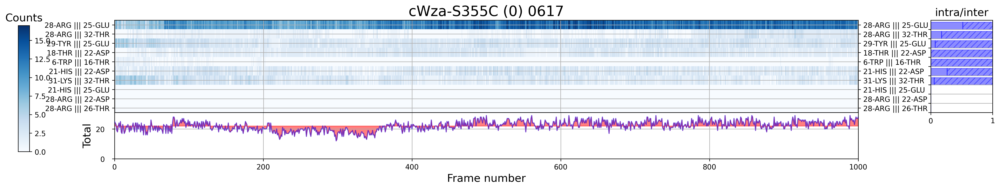

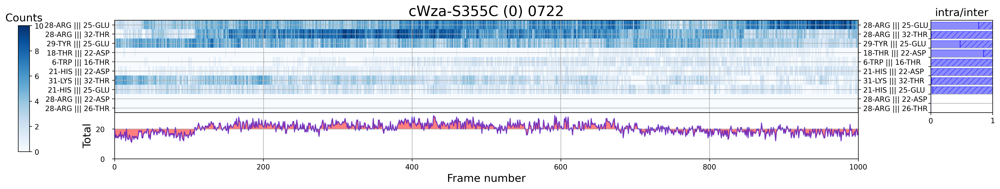

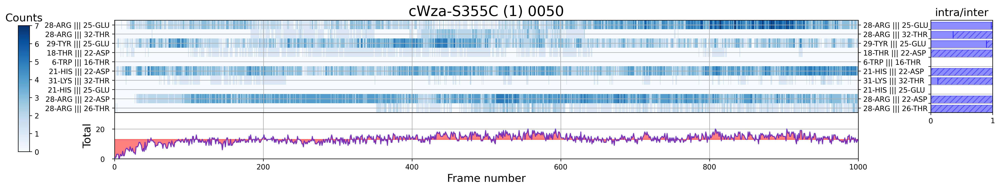

...

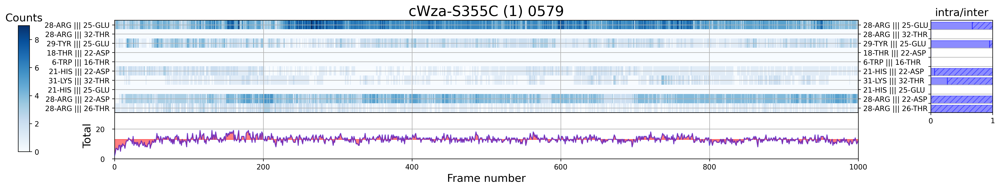

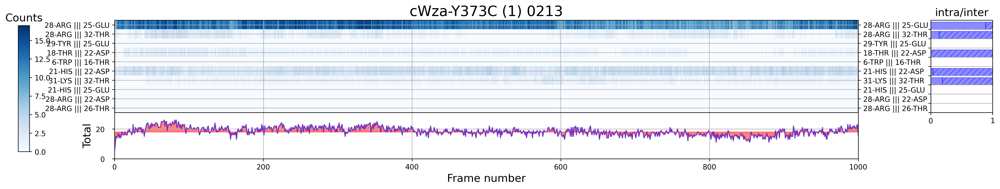

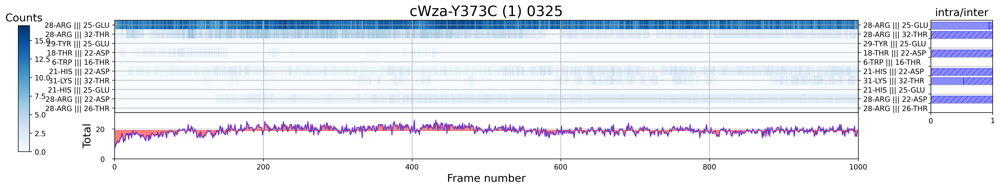

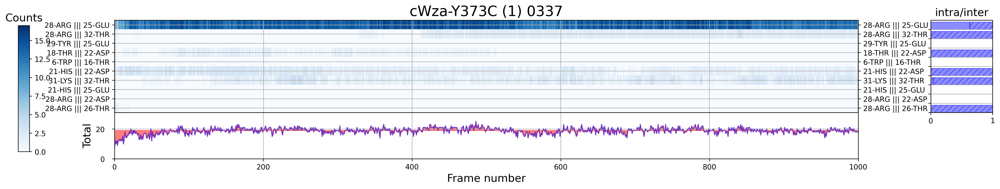

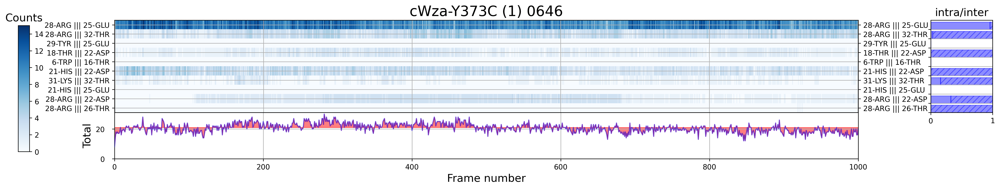

In [22]:
datadir = 'data/'
for model_name in selected_models:
    topology_filepath = os.path.join(datadir, model_name, 'md_100ns.tpr')
    trajectory_filepath = os.path.join(datadir, model_name, 'md_100ns.xtc')

    u = mda.Universe(topology_filepath, trajectory_filepath, in_memory=True)

    hbonds_filename =  os.path.join(datadir, model_name,'md_100ns.hbonds.pickle')
    with open(hbonds_filename,'rb') as fp:
        HBA_data = pickle.load(fp)

    protein_atoms = list(u.select_atoms("protein"))

    X = HBA_data
    counts_data = []
    for key in leading_hbonds:
        if key in X.keys():
            counts = HBA_data[key]['ids']
            counts_data.append(np.array(intra_to_inter_hbond_counts(counts, u, protein_atoms)))
        else:
            counts_data.append((0.0, 0.0))

    counts_data = np.array(counts_data).T

    mutant = model_name
    n_frames = 1001
    X = HBA_data

    data_matrix = np.array([np.array(X[key]['time']) if key in X.keys() else np.zeros(n_frames) for key in leading_hbonds])
    hbonds_list_sorted = np.array(leading_hbonds)
    counts_data_intrachain = counts_data[0][::-1]
    counts_data_interchain = counts_data[1][::-1]
    data_matrix_sorted = data_matrix

    fig = plt.figure(figsize=(22,3.5), dpi=250)
    gs = fig.add_gridspec(2, 2, width_ratios=[12,1], height_ratios = [2,1])
    axes = (plt.subplot(gs[0, 0]), plt.subplot(gs[0, 1]), plt.subplot(gs[1,0]))

    ax = axes[0]
    im = ax.imshow(data_matrix_sorted, 
                   origin='upper', 
                   vmin = 0,
                   vmax = data_matrix_sorted.max(),
                   interpolation='nearest',
                   aspect='auto',
                   cmap="Blues",
                   alpha=1)

    # customise colorbar
    cbar_ax = fig.add_axes([0.04, 0.15, 0.01, 0.7])
    plt.colorbar(im, cax=cbar_ax, shrink=0.01)
    # customise axes and tick labels
    ax.yaxis.set_tick_params(labelright=True, right=True)
    ax.set_xticklabels([])
    ax.set_yticks(range(len(hbonds_list_sorted)))
    y_labels = [x[0]+' ||| '+x[1] for x in list(hbonds_list_sorted)]
    ax.set_yticklabels(y_labels,fontsize=10)
    
    # customise title
    mutant, conformation, number = model_name.split('_')
    title = mutant+' ('+conformation[-1]+') '+number
    ax.set_title(title, fontsize=20)
    ax.grid("True")

    ax = axes[1]
    ax.barh(range(len(hbonds_list_sorted)), counts_data_intrachain, color='blue', align='edge', alpha=0.45, edgecolor='blue')
    ax.barh(range(len(hbonds_list_sorted)), counts_data_interchain, left = counts_data_intrachain, color='blue', hatch='///', align='edge', alpha=0.45, edgecolor='blue')
    ax.set_xticks([0, 1])
    ax.set_xlim(0,1)
    ax.set_yticks(range(len(hbonds_list_sorted)))
    ax.set_yticklabels([])
    ax.set_ylim(0, len(hbonds_list_sorted))
    ax.set_title('intra/inter', fontsize=15)
    ax.grid("True")

    ax = axes[2]
    timeseries = data_matrix_sorted.sum(axis=0)
    ax.plot(timeseries, color='blue',lw=1.5,alpha=0.5,zorder=10)
    ax.fill_between(range(1001),y1=median(timeseries),y2=timeseries, color='red',lw=1,alpha=0.5)
    ax.set_xlabel('Frame number', fontsize=15)
    ax.set_ylabel('Total', fontsize=15)
    #ax.set_yticklabels([])
    ax.tick_params(axis="y",direction="out", pad=10)
    ax.set_xlim(0,1000)
    ax.set_ylim(0, 31)
    ax.grid("True")    
    
    # #fig.tight_layout()
    plt.subplots_adjust(wspace=0.18, hspace=0)
    plt.title("Counts", fontsize=15)

    plt.show()

## Noncovalent contact heatmaps by model

In [1]:
import os
import pickle
import numpy as np
from numpy import NaN

import pandas as pd
import seaborn as sns
from statistics import median

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

In [2]:
contacts_leading =  [(25, 28),
                     (28, 29),
                     (25, 29),
                     (21, 22),
                     (7, 12),
                     (28, 32),
                     (21, 26),
                     (18, 22),
                     (14, 15),
                     (4, 8)]

In [3]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt

def get_original_chain(x, peptide_length = 32):
    N = peptide_length
    if x%N == 0:
        return x//N -1
    else:
        return x//N

def get_original_resnum(x, peptide_length = 32):
    N = peptide_length
    if x%N == 0:
        return N
    else:
        return x%N

In [6]:
workdir = 'data'
#model_name = 'cWza-Y373C_conformation1_0337'
model_name = 'cWza-S355C_conformation1_0050'
filename = 'md_100ns.contacts.pickle'

with open(os.path.join(workdir, model_name, filename),'rb') as fp:
    contacts_data = pickle.load(fp)

In [7]:
mutant_sequences = {
    'cWza': '',
    'cWza-K375C': '',
    'cWza-S355C': '',
    'cWza-Y373C': '',
}

In [8]:
with open('data/intra_inter_contacts_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

counts_data_intrachain, counts_data_interchain = counts_data[model_name]

In [ ]:

# Sum over all contact timeseries per residue combination
n_frames = 1001
contacts_nonredundant = {k:sum(v) for k,v in contacts_grouped.items() if (len(v)>1)}

# Filter out contacts according to leads
contacts_filtered = {}
for respair in contacts_leading:
    if respair in list(contacts_nonredundant.keys()):
        contacts_filtered[respair] = contacts_nonredundant[respair]
    else:
        contacts_filtered[respair] = np.zeros(n_frames)

In [ ]:
X = contacts_filtered
data_matrix = np.array(list(X.values()))

fig = plt.figure(figsize=(22,5), dpi=250)
gs = fig.add_gridspec(2, 2, width_ratios=[12,1], height_ratios = [2,1])
axes = (plt.subplot(gs[0, 0]), plt.subplot(gs[0, 1]), plt.subplot(gs[1,0]))

# Heatmap
ax = axes[0]
im = ax.imshow(data_matrix, 
               origin='upper', 
               vmin = 0,
               vmax = data_matrix.max(),
               interpolation='nearest',
               aspect='auto',
               cmap="binary",
               alpha=1)

# customise colorbar
cbar_ax = fig.add_axes([0.04, 0.15, 0.01, 0.7])
plt.colorbar(im, cax=cbar_ax, shrink=0.01)

# customise axes and tick labels
ax.yaxis.set_tick_params(labelright=True, right=True)
ax.set_xticklabels([])
ax.set_yticks(range(len(contacts_leading)))
y_labels = [str(x[0])+'-'+str(x[1]) for x in contacts_leading]
ax.set_yticklabels(y_labels,fontsize=10)
ax.grid("True")

# Barplots
ax = axes[1]
ax.barh(range(len(contacts_filtered)), 
        counts_data_intrachain, 
        color='black', 
        align='edge', 
        alpha=0.45, 
        edgecolor='black')

ax.barh(range(len(contacts_filtered)), 
        counts_data_interchain, 
        left = counts_data_intrachain, 
        color='black', 
        hatch='///', 
        align='edge', 
        alpha=0.45, 
        edgecolor='black')

ax.set_xticks([0, 1])
ax.set_xlim(0,1)
ax.set_yticks(range(len(contacts_filtered)))
ax.set_yticklabels([])
ax.set_ylim(0, len(contacts_filtered))
ax.set_title('intra/inter', fontsize=15)
ax.grid("True")

# Timeseries: total counts
ax = axes[2]
timeseries = data_matrix.sum(axis=0)
ax.plot(timeseries, color='black',lw=1.5,alpha=0.5,zorder=10)

ax.fill_between(range(1001),timeseries, color='black',lw=1,alpha=0.25)
ax.set_xlabel('Frame', fontsize=20)
ax.set_ylabel('Total', fontsize=15)
ax.tick_params(axis="y",direction="out", pad=10)
ax.set_xlim(0,1000)
ax.set_ylim(0,250)
ax.grid("True")

# #fig.tight_layout()
plt.subplots_adjust(wspace=0.18, hspace=0)
plt.title("Counts", fontsize=15)

plt.show()

## Intrachain Vs Interchain interactions

### H-bonds: Breakdown by model

In [3]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [4]:
leading_hbonds = [('28-ARG', '25-GLU'),
                  ('28-ARG', '32-THR'),
                  ('29-TYR', '25-GLU'),
                  ('18-THR', '22-ASP'),
                  ('6-TRP', '16-THR'),
                  ('21-HIS', '22-ASP'),
                  ('31-LYS', '32-THR'),
                  ('21-HIS', '25-GLU'),
                  ('28-ARG', '22-ASP'),
                  ('28-ARG', '26-THR')]

In [5]:
with open('data/intra_inter_hbonds_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

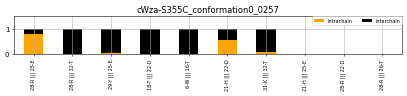

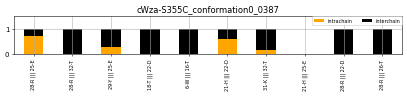

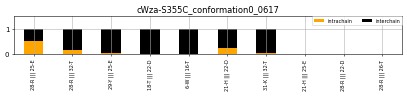

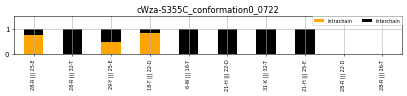

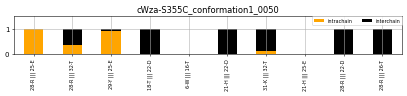

...

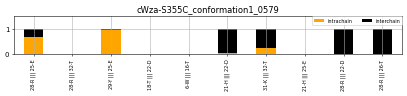

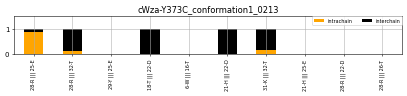

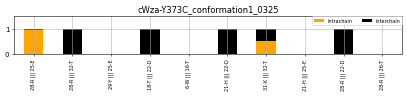

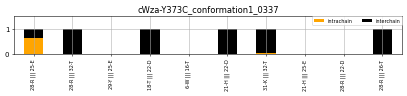

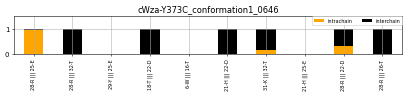

In [6]:
# Custom x-axis labels
aa_3to1 = {'CYS': 'C', 'ASP': 'D', 'SER': 'S', 'GLN': 'Q', 'LYS': 'K',
     'ILE': 'I', 'PRO': 'P', 'THR': 'T', 'PHE': 'F', 'ASN': 'N', 
     'GLY': 'G', 'HIS': 'H', 'LEU': 'L', 'ARG': 'R', 'TRP': 'W', 
     'ALA': 'A', 'VAL':'V', 'GLU': 'E', 'TYR': 'Y', 'MET': 'M'}

labels = []
for hbond in leading_hbonds:    
    donor_resn, donor_resname = hbond[0].split("-")
    acceptor_resn, acceptor_resname = hbond[1].split("-")
    hbond_label = donor_resn+'-'+aa_3to1[donor_resname]+' ||| '+acceptor_resn+'-'+aa_3to1[acceptor_resname]
    labels.append(hbond_label)

S = selected_models
for model_name in S:
    fig,axes = plt.subplots(1,1,figsize=(10,1),dpi=50)
    data = pd.DataFrame(np.array([counts_data[model_name][0], counts_data[model_name][1]]).T, 
                    columns=['intrachain','interchain'])
    
    ax = axes
    data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)
    
    ax.set_xticklabels(labels, fontsize=7)
    ax.set_ylim(0,1.5)
    ax.set_title(model_name)
    ax.grid("True")
    
    # Custom legend box
    ax.legend(loc='upper right',
              bbox_to_anchor=(1.008, 1.05),
              fontsize=7,
              ncols=2)

    plt.show()

### Noncovalent Contacts: Breakdown by model

In [7]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [8]:
with open('data/intra_inter_contacts_counts.pickle', 'rb') as fp:
    counts_data = pickle.load(fp)

In [9]:
leading_contacts = list(pd.read_csv('data/df_md_dominant_contacts.csv').index)
leading_contacts = [tuple(json.loads(x)) for x in leading_contacts]

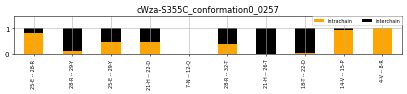

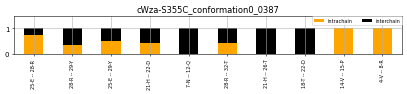

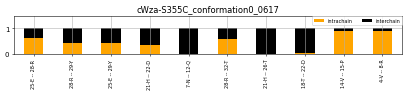

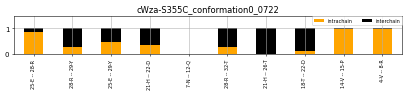

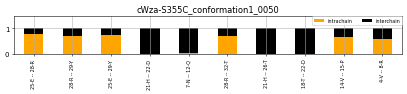

...

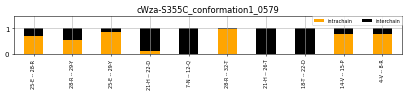

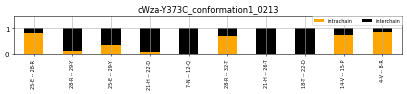

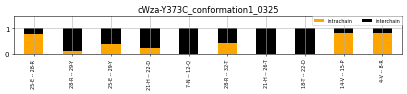

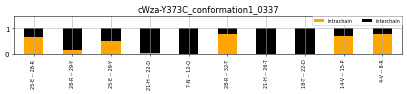

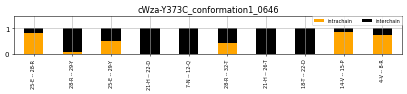

In [11]:
# Custom x-axis labels
contacts_labels = []
seq = 'APLVRWNRVISQLVPTITGVHDLTETVRYIKTWPN'
for contact in leading_contacts:
    resn_A = contact[0]
    resn_B = contact[1]
    label = str(resn_A)+'-'+seq[resn_A-1]+' -- '+str(resn_B)+'-'+seq[resn_B-1]
    contacts_labels.append(label)


S = selected_models
for model_name in S:
    fig,axes = plt.subplots(1,1,figsize=(10,1),dpi=50)
    data = pd.DataFrame(np.array([counts_data[model_name][0], counts_data[model_name][1]]).T, 
                    columns=['intrachain','interchain'])
    
    ax = axes
    data.plot(kind='bar',stacked=True,color=['orange','black'],ax=ax)
    
    ax.set_xticklabels(contacts_labels, fontsize=7)
    ax.set_ylim(0,1.5)
    ax.set_title(model_name)
    ax.grid("True")
    
    # Custom legend box
    ax.legend(loc='upper right',
              bbox_to_anchor=(1.008, 1.05),
              fontsize=7,
              ncols=2)

    plt.show()